## Data Survey to start with

## Import packages


In [3]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline

## Calibration Data

In [84]:
def grid_display(list_of_images,  no_of_columns=4, figsize=(10,10)):

    fig = plt.figure(figsize=figsize)
    column = 0
    for i in range(len(list_of_images)):
        column += 1
        #  check for end of column and create a new figure
        if column == no_of_columns+1:
            fig = plt.figure(figsize=figsize)
            column = 1
        fig.add_subplot(1, no_of_columns, column)
        plt.imshow(list_of_images[i])

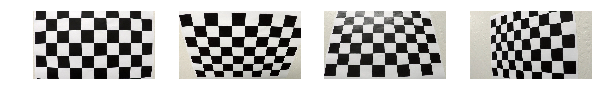

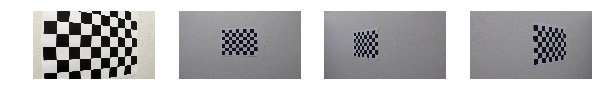

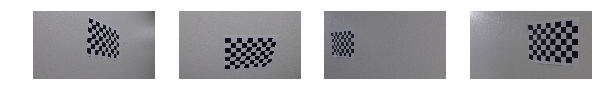

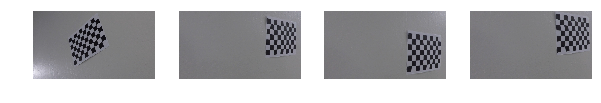

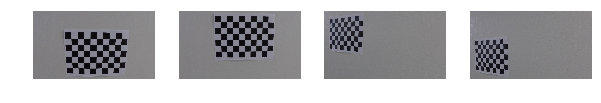

In [7]:
calibration_images = []
for i in range(21):
    if i == 0:
        continue
    image_path = "./camera_cal/calibration" + str(i) + ".jpg"
    img = cv2.imread(image_path)
    conv_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    calibration_images.append(conv_img)

grid_display(calibration_images, 4, (10,10))

## Test Data

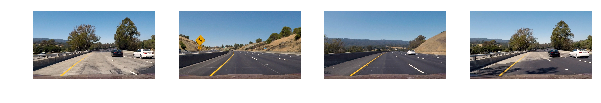

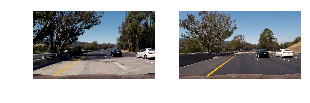

In [8]:
test_images = []
for i in range(7):
    if i == 0:
        continue
    image_path = "./test_images/test" + str(i) + ".jpg"
    img = cv2.imread(image_path)
    conv_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    test_images.append(conv_img)

grid_display(test_images, 4, (10,10))

## Project Video

In [10]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
project_video = './project_video.mp4'

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_video))

## Camera callibration and distortion correction

First step, to identify the distortion correction matrix using the camera callibration techniques

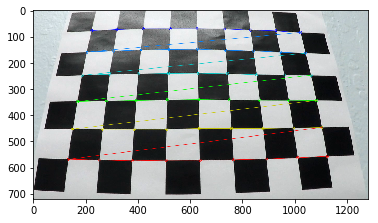

In [12]:
nx = 9
ny = 6

fname = './camera_cal/calibration3.jpg'
img = cv2.imread(fname)
# Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Find the chessboard corners
ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

# If found, draw corners
if ret == True:
    # Draw and display the corners
    cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
    plt.imshow(img)

In [14]:
import glob
%matplotlib qt

objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        cv2.imshow('img', img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

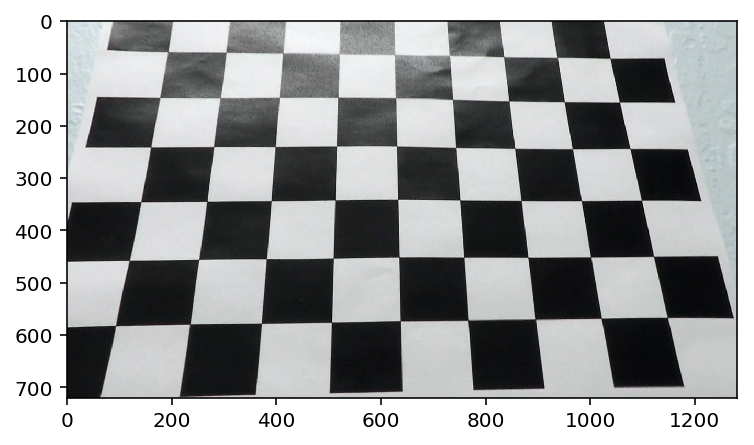

In [15]:
fname = './camera_cal/calibration3.jpg'
img = cv2.imread(fname)
# Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
dst = cv2.undistort(img, mtx, dist, None, mtx)
plt.imshow(dst)

Check correction on all the calibration images

In [17]:
def undistort_image(img):
    return cv2.undistort(img, mtx, dist, None, mtx)

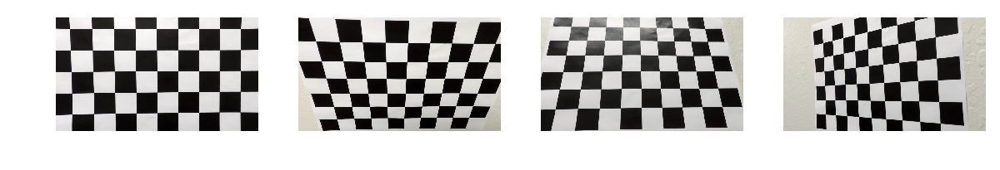

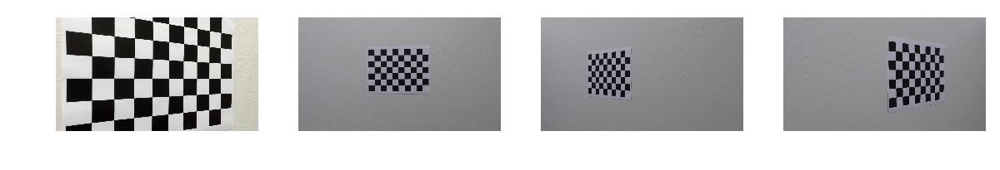

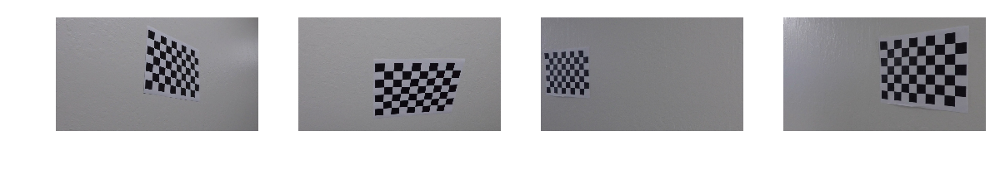

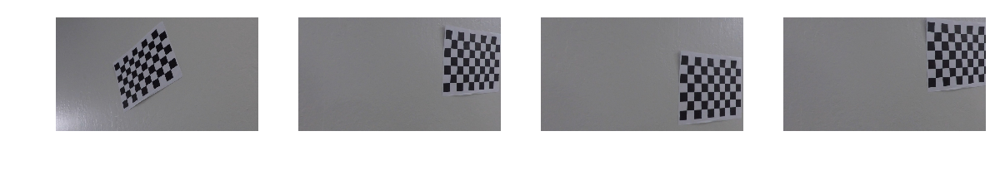

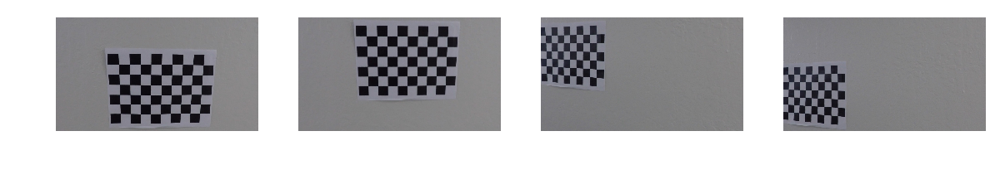

In [19]:
corrected_calibration_images = []
for i in range(21):
    if i == 0:
        continue
    image_path = "./camera_cal/calibration" + str(i) + ".jpg"
    img = cv2.imread(image_path)
    conv_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    corrected_img = undistort_image(conv_img)
    corrected_calibration_images.append(corrected_img)

grid_display(corrected_calibration_images, 4, (10,10))

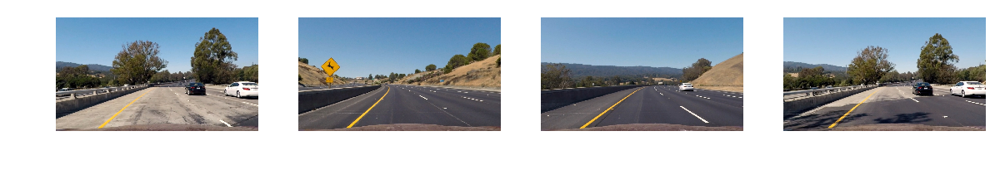

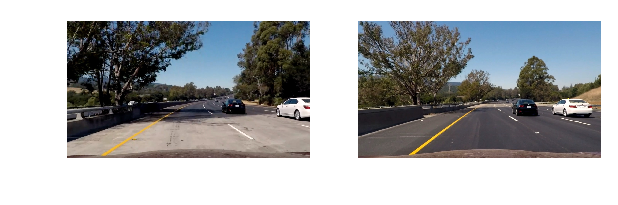

In [21]:
test_images_undistorted = []
for i in range(7):
    if i == 0:
        continue
    image_path = "./test_images/test" + str(i) + ".jpg"
    img = cv2.imread(image_path)
    conv_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    corrected_img = undistort_image(conv_img)
    test_images_undistorted.append(corrected_img)
    write_img = cv2.cvtColor(corrected_img, cv2.COLOR_RGB2BGR)
    cv2.imwrite("./output_images/test_undistorted_" + str(i) + ".jpg", write_img)

grid_display(test_images_undistorted, 4, (10,10))

## Experimenting with color and gradient thresholds

In [29]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    abs_sobelx = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return sxbinary

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    abs_sobelxy = np.sqrt(np.square(sobel_x) + np.square(sobel_y))
    scaled_sobel = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    return sxbinary

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    abs_sobelx = np.absolute(sobel_x)
    abs_sobely = np.absolute(sobel_y)
    gradient_direction = np.arctan2(abs_sobely, abs_sobelx)
    sxbinary = np.zeros_like(gradient_direction)
    sxbinary[(gradient_direction >= thresh[0]) & (gradient_direction <= thresh[1])] = 1
    return sxbinary

def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary

In [95]:
def apply_color_gradient_threshold(conv_img):
    gradx = abs_sobel_thresh(conv_img, orient='x', thresh_min=20, thresh_max=75)
    grady = abs_sobel_thresh(conv_img, orient='x', thresh_min=20, thresh_max=75)
    mag_binary = mag_thresh(conv_img, sobel_kernel=9, mag_thresh=(50, 100))
    dir_binary = dir_threshold(conv_img, sobel_kernel=9, thresh=(0.75, 1.1))
    s_binary = hls_select(conv_img, thresh=(130, 255))
    combined = np.zeros_like(dir_binary)
    combined[((mag_binary == 1) & (dir_binary == 1)) | (s_binary == 1) | ((gradx == 1) & (grady == 1))] = 1
    return combined

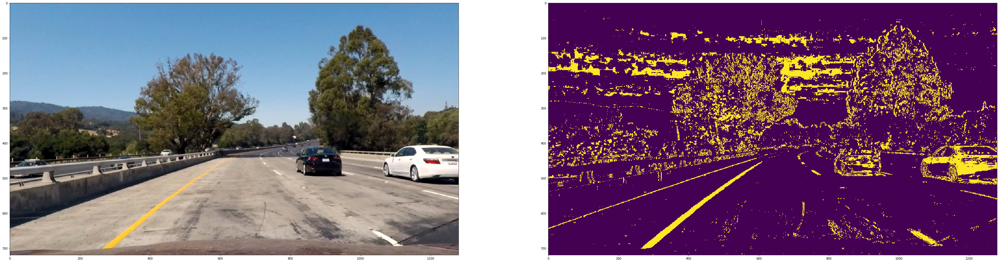

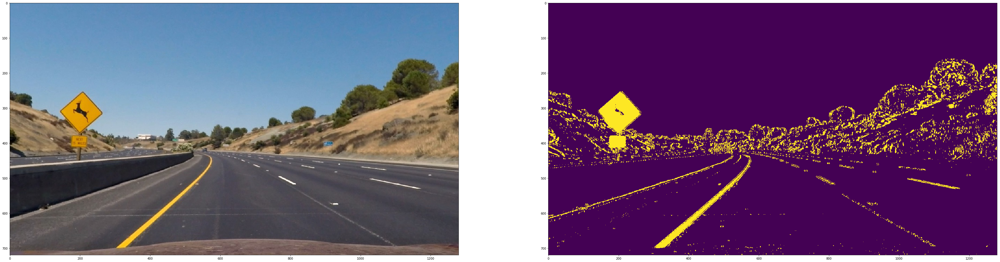

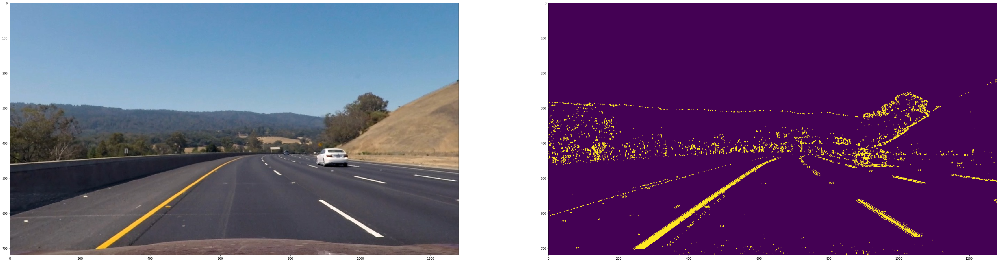

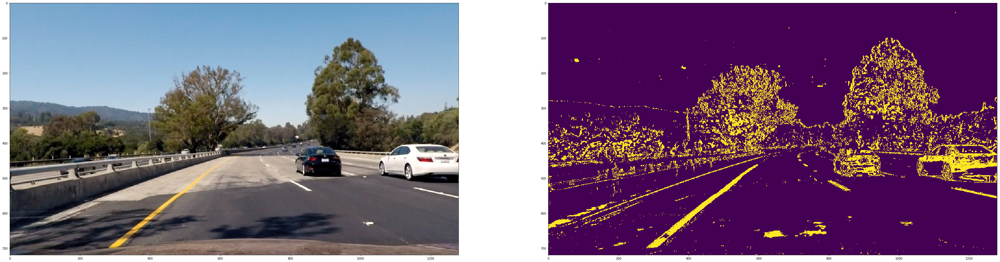

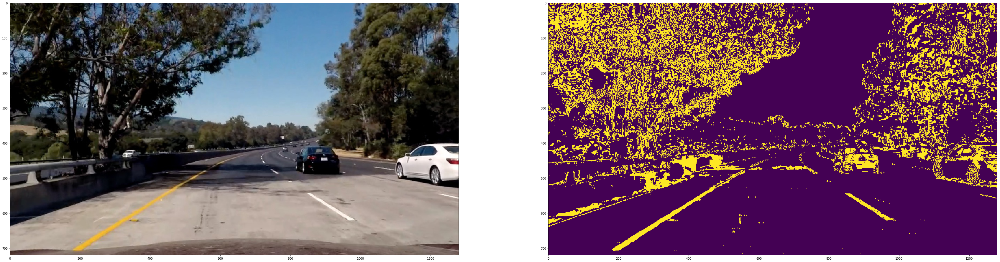

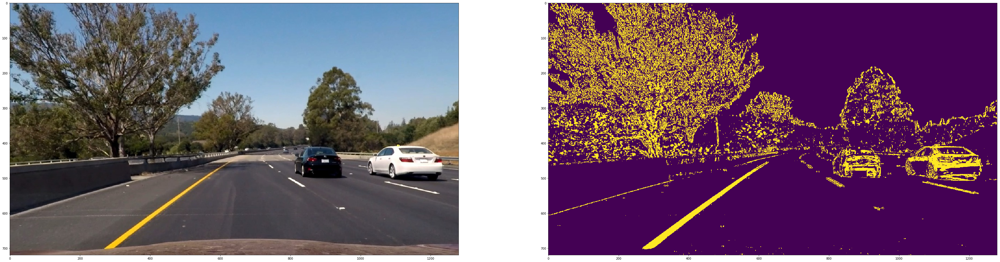

In [96]:
%matplotlib inline
display_images = []
thresholded_images = []
for i in range(7):
    if i == 0:
        continue
    image_path = "./output_images/test_undistorted_" + str(i) + ".jpg"
    img = cv2.imread(image_path)
    conv_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    display_images.append(conv_img)
    combined = apply_color_gradient_threshold(conv_img)
    display_images.append(combined)
    thresholded_images.append(combined)
    plt.imsave("./output_images/test_thresholded_" + str(i) + ".jpg", combined)
    
grid_display(display_images, 2, (60,60))


In [97]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

In [98]:
def mask_region(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.copy(img)
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, 0)
    return mask

In [ ]:
imshape = thresholded_images[0].shape
high_p = int(imshape[0]/2) + 50
width = imshape[1]
wp = int(width/10)
shift = int(width/20)
vertices = np.array([[(wp,imshape[0]),(wp*4+shift, high_p),
                      (wp*5+shift, high_p), (wp*9+shift,imshape[0])]
                    ], dtype=np.int32)
vertices_in = np.array([[(wp*2+shift,imshape[0]),(wp*5, high_p+shift),
                         (wp*5+shift, high_p+shift), (wp*8+shift,imshape[0])]
                       ], dtype=np.int32)

def mask_image(image):
    interest_image = region_of_interest(image, vertices)
    masked_image = mask_region(interest_image, vertices_in)
    return masked_image

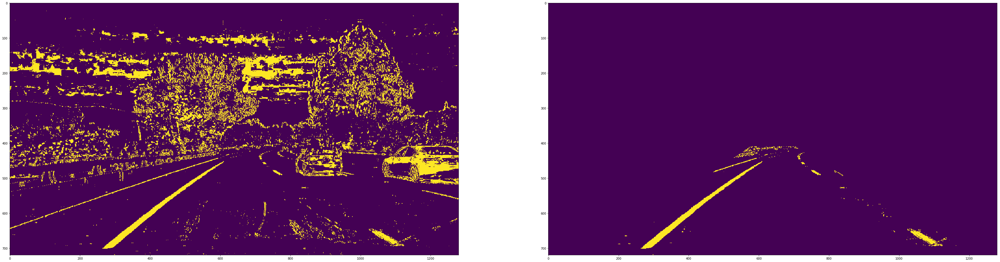

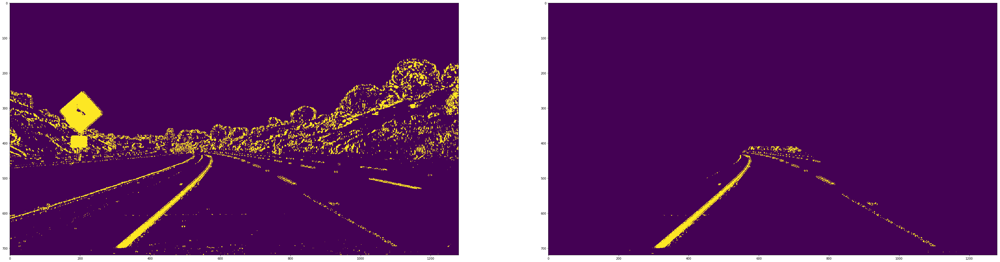

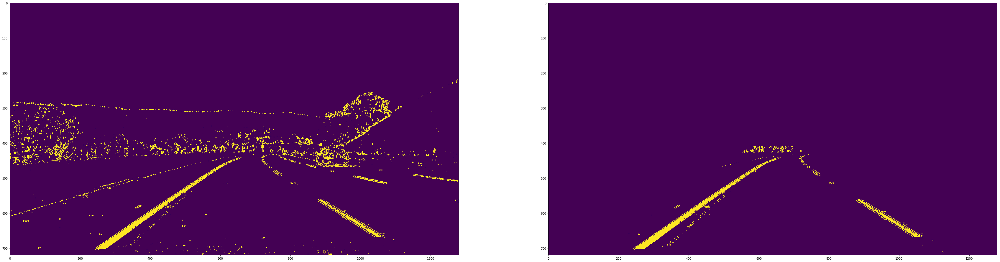

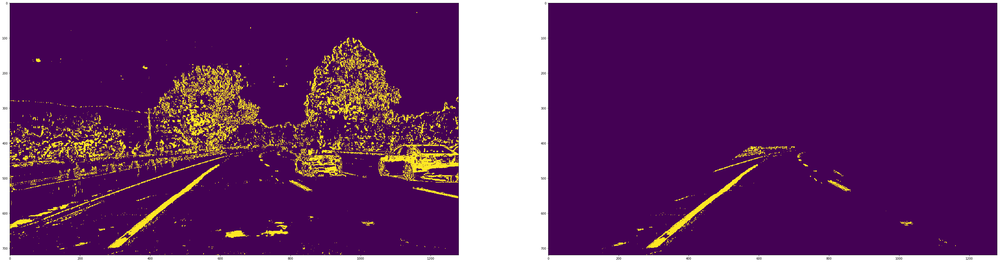

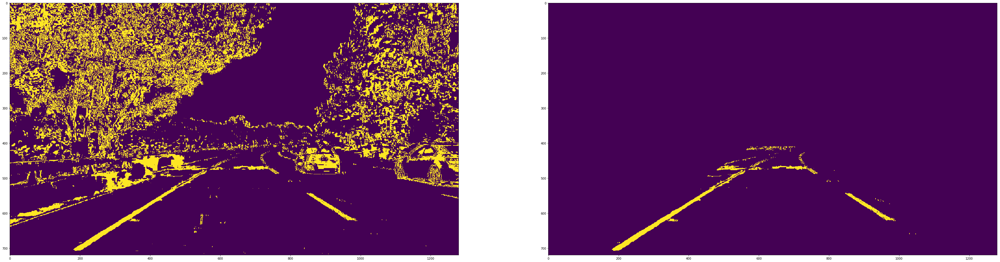

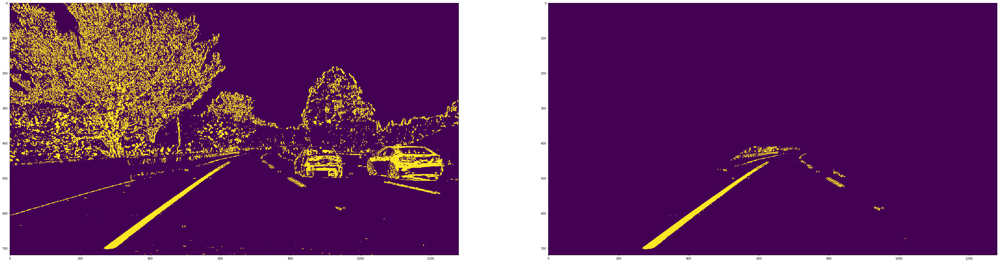

In [115]:
display_images = []
masked_images = []
count = 1
for image in thresholded_images:
    
    display_images.append(image)
    interest_image = region_of_interest(image, vertices)
    masked_image = mask_region(interest_image, vertices_in)
    display_images.append(masked_image)
    masked_images.append(masked_image)
    plt.imsave("./output_images/test_masked_" + str(count) + ".jpg", masked_image)
    count += 1

grid_display(display_images, 2, (60,60))

## Perspective transform

(720, 1280, 3)


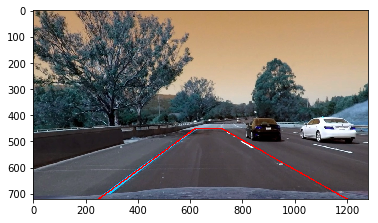

In [116]:
# Identifying the trapezium

img = cv2.imread("./output_images/test_undistorted_6.jpg")
color=[255, 0, 0]
cv2.line(img, (250,720), (620, 450), color, 4)
cv2.line(img, (620,450), (720, 450), color, 4)
cv2.line(img, (720,450), (1200, 720), color, 4)
print (img.shape)
plt.imshow(img)

In [117]:
src = np.float32([
    [250,720],
    [620,450],
    [720,450],
    [1200, 720]])
dst = np.float32([
    [300,720],
    [300,0],
    [1100,0],
    [1100, 720]])

M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)

def warp_image(image):
    return cv2.warpPerspective(image, M, (image.shape[1], image.shape[0]), flags=cv2.INTER_LINEAR)

def unwarp_image(image):
    return cv2.warpPerspective(image, Minv, (image.shape[1], image.shape[0]), flags=cv2.INTER_LINEAR)

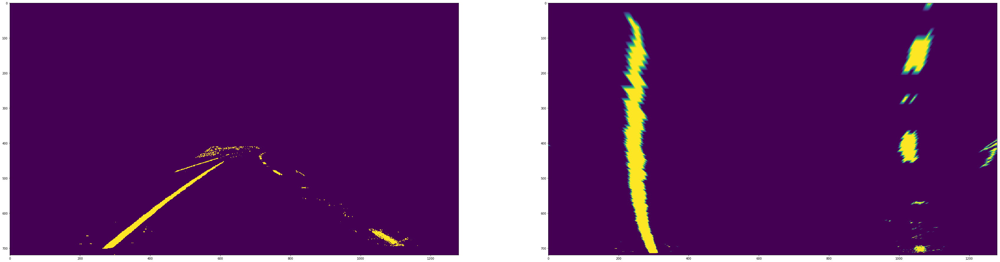

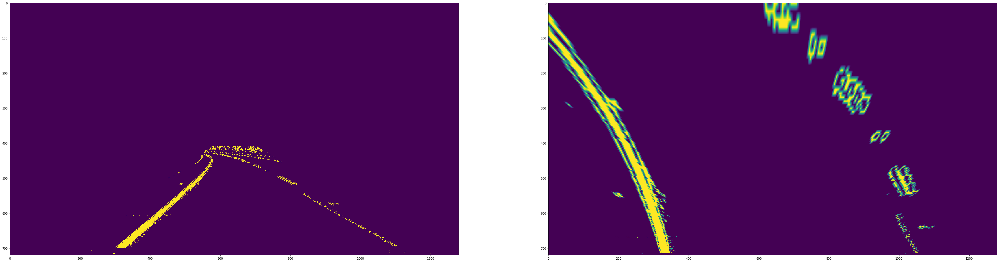

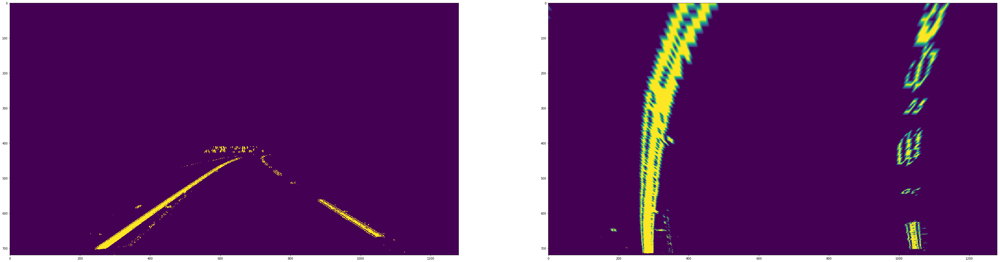

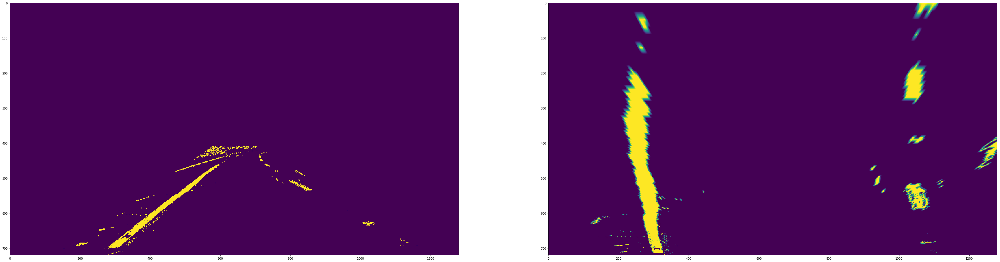

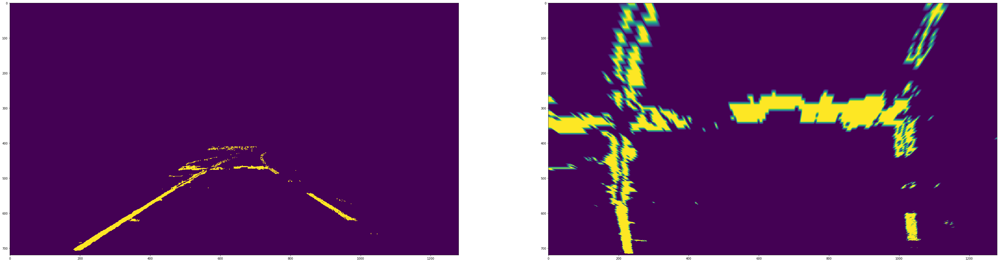

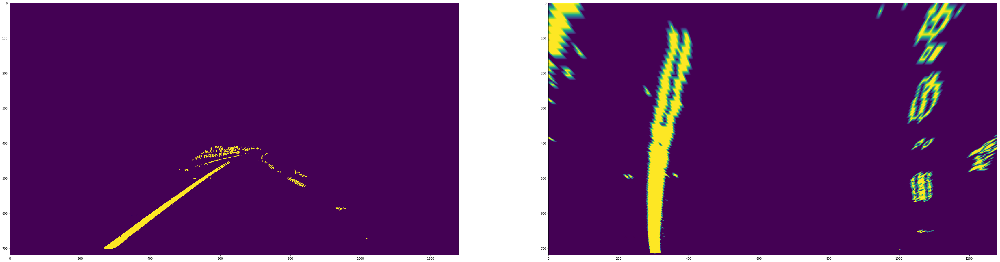

In [118]:
display_images = []
warped_images = []
count = 1
for image in masked_images:
    
    display_images.append(image)
    warped_image = warp_image(image)
    display_images.append(warped_image)
    warped_images.append(warped_image)
    plt.imsave("./output_images/test_warped_" + str(count) + ".jpg", warped_image)
    count += 1

grid_display(display_images, 2, (60,60))

In [196]:
ym_per_pix = 30.0/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

def calculate_curvature(lefty, righty, leftx, rightx):
    # Fit new polynomials to x,y in world space
    y_eval = np.max(lefty)
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm')

In [205]:
def check_vehicle_position(left_fit, right_fit, width, height):
    left_x_bottom = left_fit[0]*height**2 + left_fit[1]*height + left_fit[2]
    right_x_bottom = right_fit[0]*height**2 + right_fit[1]*height + right_fit[2]
    midpoint = (left_x_bottom + right_x_bottom) / 2.0
    image_mid = width / 2.0
    if image_mid > midpoint:
        print ('right of lane mid by ', xm_per_pix * (image_mid - midpoint), 'm')
    else:
        print ('left of lane mid by ', xm_per_pix * (midpoint - image_mid), 'm')

In [214]:
def sliding_window_fit_polynomial(binary_warped):
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    out_img = out_img.astype(np.uint8)
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    nwindows = 9
    window_height = np.int(binary_warped.shape[0]/nwindows)
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    leftx_current = leftx_base
    rightx_current = rightx_base
    margin = 100
    minpix = 50
    left_lane_inds = []
    right_lane_inds = []
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    check_vehicle_position(left_fit, right_fit, binary_warped.shape[1], binary_warped.shape[0])
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    calculate_curvature(lefty, righty, leftx, rightx)

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    return left_fit, right_fit, left_fitx, right_fitx, ploty, out_img

left of lane mid by  0.197748523602 m
804.786061479 m 396.641760883 m
left of lane mid by  0.299039455656 m
407.507697625 m 275.713828692 m
left of lane mid by  0.171696479992 m
407.640613755 m 456.644589676 m
left of lane mid by  0.322702936811 m
541.302681982 m 537.166238873 m
left of lane mid by  0.105583370863 m
497.738933968 m 176.753981785 m
left of lane mid by  0.253036544763 m
979.121947691 m 663.06154606 m


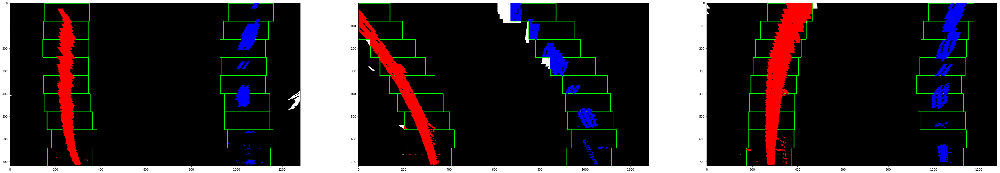

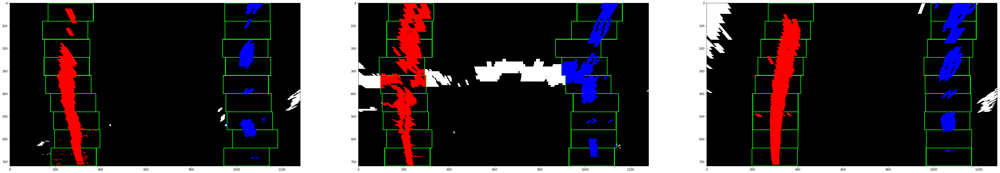

In [215]:
display_images = []

count = 1
for warped_image in warped_images:
    binary_w = np.zeros_like(warped_image)
    binary_w[warped_image > 0] = 1
    _, _, _, _, _, result_image = sliding_window_fit_polynomial(binary_w)
    plt.imsave("./output_images/test_sliding_window_" + str(count) + ".jpg", result_image)
    display_images.append(result_image)
    count += 1

grid_display(display_images, 3, (60,60))

In [216]:
def lines_for_subsequent_frame(binary_warped, left_fit, right_fit):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    calculate_curvature(lefty, righty, leftx, rightx)
    check_vehicle_position(left_fit, right_fit, binary_warped.shape[1], binary_warped.shape[0])
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    out_img = out_img.astype(np.uint8)
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    return left_fit, right_fit, left_fitx, right_fitx, ploty, result

left of lane mid by  0.197748523602 m
804.786061479 m 396.641760883 m
801.934007713 m 396.641760883 m
left of lane mid by  0.198046596329 m
left of lane mid by  0.299039455656 m
407.507697625 m 275.713828692 m
417.780592314 m 233.670276894 m
left of lane mid by  0.291153078179 m
left of lane mid by  0.171696479992 m
407.640613755 m 456.644589676 m
375.276066395 m 456.644589676 m
left of lane mid by  0.18095884953 m
left of lane mid by  0.322702936811 m
541.302681982 m 537.166238873 m
505.159289664 m 539.452146184 m
left of lane mid by  0.328392535742 m
left of lane mid by  0.105583370863 m
497.738933968 m 176.753981785 m
615.410594664 m 165.193908916 m
left of lane mid by  0.10038089948 m
left of lane mid by  0.253036544763 m
979.121947691 m 663.06154606 m
979.121947691 m 558.543896155 m
left of lane mid by  0.266170446567 m


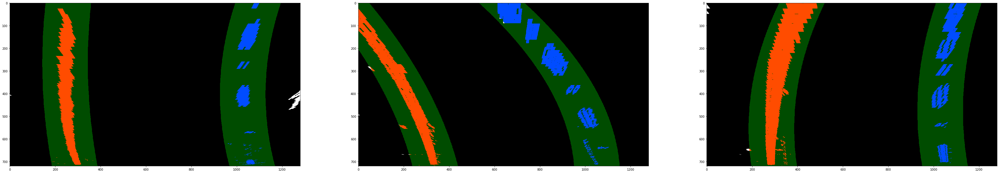

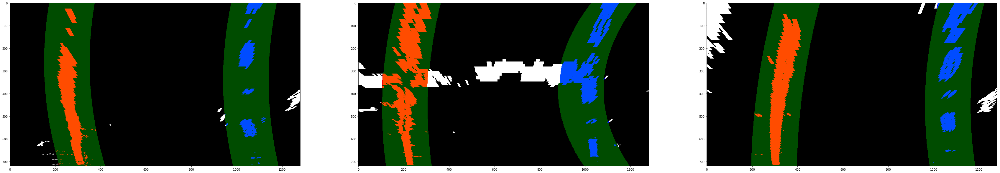

In [218]:
display_images = []

count = 1
for warped_image in warped_images:
    binary_w = np.zeros_like(warped_image)
    binary_w[warped_image > 0] = 1
    lf, rf, _, _, _, _ = sliding_window_fit_polynomial(binary_w)
    _, _, _, _, _, result_image = lines_for_subsequent_frame(binary_w, lf, rf)
    plt.imsave("./output_images/test_previous_frame_" + str(count) + ".jpg", result_image)
    display_images.append(result_image)
    count += 1

grid_display(display_images, 3, (60,60))

left of lane mid by  0.197748523602 m
804.786061479 m 396.641760883 m
left of lane mid by  0.299039455656 m
407.507697625 m 275.713828692 m
left of lane mid by  0.171696479992 m
407.640613755 m 456.644589676 m
left of lane mid by  0.322702936811 m
541.302681982 m 537.166238873 m
left of lane mid by  0.105583370863 m
497.738933968 m 176.753981785 m
left of lane mid by  0.253036544763 m
979.121947691 m 663.06154606 m


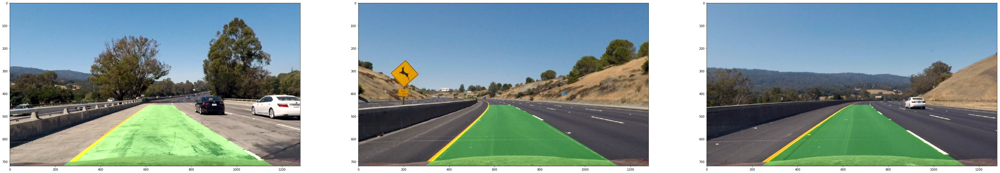

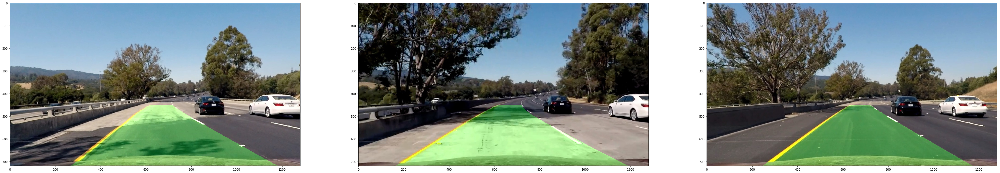

In [219]:
def get_color_warp(binary_w, left_fitx, right_fitx, ploty):
    warp_zero = np.zeros_like(binary_w).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    newwarp = cv2.warpPerspective(color_warp, Minv, (binary_w.shape[1], binary_w.shape[0]))
    return newwarp

def get_lane_drawing_image(original_undist, binary_w, left_fitx, right_fitx, ploty):
    newwarp = get_color_warp(binary_w, left_fitx, right_fitx, ploty)
    result = cv2.addWeighted(original_undist, 1, newwarp, 0.3, 0)
    return result

display_images = []

count = 1
for warped_image in warped_images:
    binary_w = np.zeros_like(warped_image)
    binary_w[warped_image > 0] = 1
    _, _, lfx, rfx, py, _ = sliding_window_fit_polynomial(binary_w)
    original_path = "./output_images/test_undistorted_" + str(count) + ".jpg"
    cv_img = cv2.imread(original_path)
    undist_img = cv2.cvtColor(cv_img, cv2.COLOR_BGR2RGB)
    result_image = get_lane_drawing_image(undist_img, binary_w, lfx, rfx, py)
    plt.imsave("./output_images/test_lane_drawn_" + str(count) + ".jpg", result_image)
    display_images.append(result_image)
    count += 1

grid_display(display_images, 3, (60,60))